In [1]:
import matplotlib.patches as patches
import matplotlib.colors as mcolors
import matplotlib.animation as ma
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from itertools import product
import pandas as pd
import numpy as np
import numba as nb
import imageio
import json
import os
import shutil
import sys
sys.path.append("..")

from PJT_Frustration_Induced_Crystallize.main import *

randomSeed = 100

%matplotlib inline
%config InlineBackend.figure_format = "retina"

new_cmap = mcolors.LinearSegmentedColormap.from_list(
    "new", plt.cm.hsv(np.linspace(0, 1, 256)) * 0.85, N=256
)

@nb.njit
def colors_idx(phaseTheta):
    return np.floor(256 - phaseTheta / (2 * np.pi) * 256).astype(np.int32)

with open("../swarmalatorlib/hex_colors.json", "r", encoding="utf-8") as f:
    hexColors = json.load(f)
hexCmap = mcolors.LinearSegmentedColormap.from_list("cmap", hexColors)


import seaborn as sns

sns.set_theme(
    style="ticks", 
    font_scale=1.1, rc={
    'figure.figsize': (6, 5),
    'axes.facecolor': 'white',
    'figure.facecolor': 'white',
    'grid.color': '#dddddd',
    'grid.linewidth': 0.5,
    "lines.linewidth": 1.5,
    'text.color': '#000000',
    'figure.titleweight': "bold",
    'xtick.color': '#000000',
    'ytick.color': '#000000'
})

plt.rcParams['mathtext.fontset'] = 'cm'
plt.rcParams['font.family'] = 'STIXGeneral'
#plt.rcParams['animation.ffmpeg_path'] = "/opt/conda/bin/ffmpeg"

from multiprocessing import Pool
import pandas as pd

colors = ["#403990", "#3A76D6", "#FFC001", "#F46F43", "#FF0000"]
cmap = mcolors.LinearSegmentedColormap.from_list("cmap", colors)
# cmap_r = mcolors.LinearSegmentedColormap.from_list("my_colormap", colors[::-1])

colors = ["#403990", "#80A6E2", "#F46F43", "#CF3D3E"]
cmap2 = mcolors.LinearSegmentedColormap.from_list("cmap2", colors)

SAVE_PATH = r"F:\MS_ExperimentData\general"
MP4_PATH = r"F:\MS_ExperimentData\mp4"

# SAVE_PATH = r"D:\MS_ExperimentData\general"
# MP4_PATH = r"D:\MS_ExperimentData\mp4"

# LOCAL_FIG_PATH = "./PCT_C_figs"
LOCAL_FIG_PATH = "./figs"

In [2]:
phaseLags = [0.9 * np.pi]  # 0.6, 0.9
omegaMins = [0]  # np.linspace(1e-5, 3, 21)
randomSeed = 10
strengthKs = np.linspace(4, 20, 19)
distanceD0s = np.linspace(0.3, 1.1, 19)  
deltaOmegas = [0]  # np.linspace(1e-5, 3, 21)  # [1.0]

models = [
    PhaseLagPatternFormation(
        strengthK=strengthK, distanceD0=distanceD0, phaseLagA0=phaseLag,
        freqDist="uniform", initPhaseTheta=None,
        omegaMin=omegaMin, deltaOmega=deltaOmega, 
        agentsNum=2000, dt=0.005,
        tqdm=True, savePath=SAVE_PATH, shotsnaps=10, 
        randomSeed=randomSeed, overWrite=False
    )
    for strengthK in strengthKs
    for distanceD0 in distanceD0s
    for omegaMin in omegaMins
    for deltaOmega in deltaOmegas
    for phaseLag in phaseLags
]

In [5]:
phaseLags = [0.9 * np.pi]  # 0.6, 0.9
omegaMins = [0]  # np.linspace(1e-5, 3, 21)
randomSeed = 10 
strengthKs = np.linspace(1, 20, 19)
distanceD0s = np.linspace(0.1, 3, 19)  
deltaOmegas = [0]  # np.linspace(1e-5, 3, 21)  # [1.0]
models = [
    PhaseLagPatternFormation(
        strengthK=strengthK, distanceD0=distanceD0, phaseLagA0=phaseLag,
        freqDist="uniform", initPhaseTheta=None,
        omegaMin=omegaMin, deltaOmega=deltaOmega, 
        agentsNum=2000, dt=0.005,
        tqdm=True, savePath=SAVE_PATH, shotsnaps=10, 
        randomSeed=randomSeed, overWrite=False
    )
    for strengthK in strengthKs
    for distanceD0 in distanceD0s
    for omegaMin in omegaMins
    for deltaOmega in deltaOmegas
    for phaseLag in phaseLags
]

In [ ]:
sas = list()
for model in tqdm(models):
    try:
        sa = StateAnalysis(model)
    except:
        sa = None
    sas.append(sa)

In [6]:
savePath = (
    f"last_state/{models[0].__class__.__name__}_"
    f"{models[0].freqDist}_"
    f"omegaMin{models[0].omegaMin:.3f}_deltaOmega{models[0].deltaOmega:.3f}_"
    f"phaseLagA0{models[0].phaseLagA0:.3f}_"
    f"Ks{strengthKs[0]:.3f}-{strengthKs[-1]:.3f}-{len(strengthKs)}_"
    f"D0s{distanceD0s[0]:.3f}-{distanceD0s[-1]:.3f}-{len(distanceD0s)}_"
    f"lastState.h5"
)
modelsNum = len(models)

sas = list()
allPositionX = pd.read_hdf(savePath, key="positionX")
allPhaseTheta = pd.read_hdf(savePath, key="phaseTheta")
allPositionX = allPositionX.values.reshape(modelsNum, models[0].agentsNum, 2)
allPhaseTheta = allPhaseTheta.values.reshape(modelsNum, models[0].agentsNum)

for i, model in enumerate(models):
    sa = StateAnalysis()
    sa.model = model
    sa.totalPositionX = np.array([allPositionX[i]])
    sa.totalPhaseTheta = np.array([allPhaseTheta[i]])
    sas.append(sa)

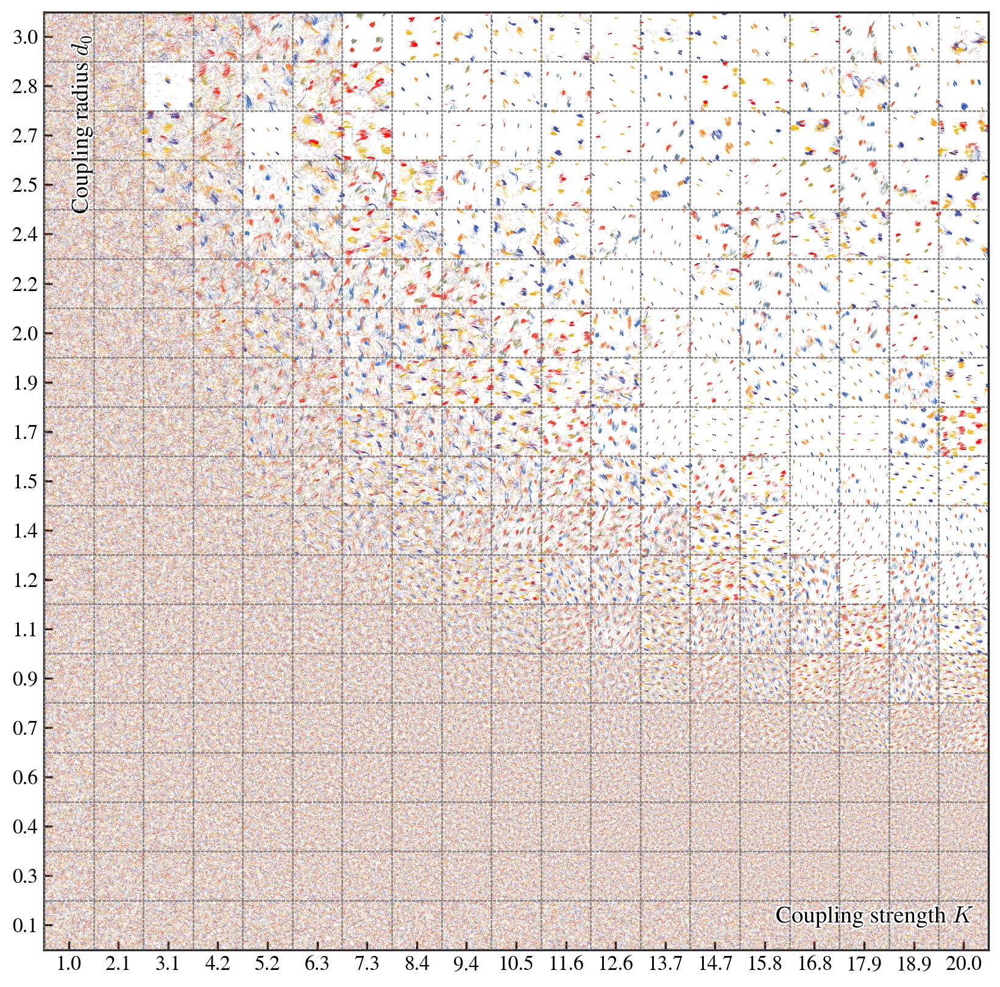

In [8]:
from matplotlib.patheffects import withStroke

colParams = distanceD0s[::]
rowParams = strengthKs[::]
colorsBy = "phase"

# fig, ax = plt.subplots(figsize=(len(rowParams) * 4, len(colParams) * 4))
fig, ax = plt.subplots(figsize=(10, 10))

for i in range(len(colParams) * len(rowParams)):
    row = i // len(rowParams)
    col = i % len(rowParams)
    sa = [sa for sa in sas 
          if (sa.model.strengthK == rowParams[row]) and
             (sa.model.distanceD0 == colParams[col])][0]
    
    positionShift = np.array([row, col]) * sa.model.boundaryLength
    positionX, phaseTheta = sa.get_state(-1)
    positionX = positionX + positionShift
    if colorsBy == "freq":
        colors = (
            ["red"] * (sa.model.freqOmega >= 0).sum() + 
            ["#414CC7"] * (sa.model.freqOmega < 0).sum()
        )
    elif colorsBy == "phase":
        colors = [cmap(i) for i in
            np.floor(256 - phaseTheta / (2 * np.pi) * 256).astype(np.int32)
        ]

    ax.quiver(
        positionX[:, 0], positionX[:, 1],
        np.cos(phaseTheta), np.sin(phaseTheta), 
        color=colors,
        scale=300, width=0.0004 / len(rowParams) * 7
    )
    ax.axhline(
        y=col * sa.model.boundaryLength, 
        color="gray", linewidth=0.5, linestyle="--", alpha=0.3, zorder=100
    )
    ax.axvline(
        x=row * sa.model.boundaryLength, 
        color="gray", linewidth=0.5, linestyle="--", alpha=0.3, zorder=100
    )

boundaryLength = models[0].boundaryLength
plt.xlim(0, len(rowParams) * boundaryLength)
plt.ylim(0, len(colParams) * boundaryLength)
plt.xticks(
    np.arange(0, len(rowParams) * boundaryLength, boundaryLength) + boundaryLength / 2,
    [f"{k:.1f}" for k in rowParams]
)
plt.yticks(
    np.arange(0, len(colParams) * boundaryLength, boundaryLength) + boundaryLength / 2,
    [f"{d:.1f}" for d in colParams]
)

text1 = plt.text(len(rowParams) * boundaryLength * 0.88, len(rowParams) * boundaryLength * 0.035,
                 "Coupling strength $K$", # weight="bold",
                 fontsize=14, ha="center", va="center")
text2 = plt.text(len(rowParams) * boundaryLength * 0.04, len(rowParams) * boundaryLength * 0.88,
                 "Coupling radius $d_0$", # weight="bold",
                 fontsize=14, ha="center", va="center", rotation=90)
for text in [text1, text2]:
    text.set_path_effects([withStroke(linewidth=2, foreground='white')])
plt.tick_params(length=5, direction="in")
# plt.savefig(
#     f"figs/{sa.model.__class__.__name__}_"
#     f"varying_strengthK_and_distanceD0_{colorsBy}_"
#     f"a{phaseLags[0]:.2f}_Do{deltaOmegas[0]}"
#     f"{'initPhaseTheta,' if sa.model.initPhaseTheta is not None else ''}"
#     f"_aN{sa.model.agentsNum}_dist{sa.model.freqDist}.png", 
#     bbox_inches="tight"
# )

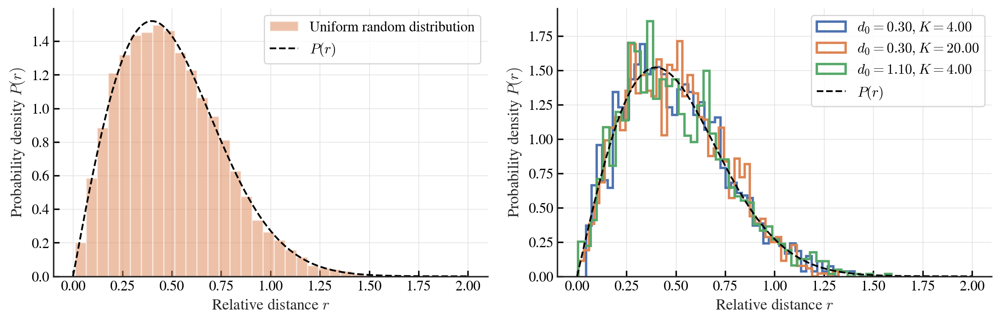

In [125]:
fig, axs = plt.subplots(1, 2, figsize=(12, 4))
ax1, ax2 = axs

ax1.hist(dsI, density=True, bins=30, alpha=0.5, color="C1", label="Uniform random distribution")

for (d0, K), dsF in totalDsF.items():
    ax2.hist(dsF, density=True, bins=50, histtype='step', lw=2, label=f"$d_0={d0:.2f}, K={K:.2f}$")

rs = np.linspace(0, 2, 1000)
Pr = 2*np.pi*rs * np.exp(-np.pi * rs**2)
for ax in axs:
    ax.plot(rs, Pr, color="black", linewidth=1.5, label="$P(r)$", ls="--")
    ax.legend()
    ax.tick_params(length=5, direction="in")
    ax.grid()
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.set_xlabel("Relative distance $r$")
    ax.set_ylabel("Probability density $P(r)$")

plt.tight_layout()
plt.savefig("figs/uniform.pdf", bbox_inches="tight")

In [9]:
def calc_lattice_constants(sa: StateAnalysis, plot: bool = False, lookIdx: int = -1):

    sa: StateAnalysis
    model = sa.model
    shift = np.array([0., 0.])
    analysisRadius = model.speedV / np.abs(model.strengthK * np.sin(model.phaseLagA0))

    classes, centers = sa.calc_classes_and_centers(classDistance=analysisRadius, lookIdx=lookIdx)
    if len(classes) > model.agentsNum * 0.2:
        # print(f"Too many classes: {len(classes)} > {model.agentsNum * 0.2}, skipping.")
        return [], []
    numInClasses = np.array([len(c) for c in classes])
    # zScoreNum = stats.zscore(numInClasses)
    # classes = [classes[c] for c in range(len(classes)) 
    #            if (zScoreNum[c] > -0.4) and (numInClasses[c] > 10)]
    numThres = np.median(numInClasses[numInClasses > 10]) * 0.
    classes = [classes[c] for c in range(len(classes))
               if (numInClasses[c] > max(numThres, 10))]
    centers = np.mod(centers + shift, model.boundaryLength)
    if len(classes) <= 1:
        # print("Not enough classes, skipping.")
        return [], []

    classCenters: List[np.ndarray] = []
    for c in classes:
        singleClassCenters = centers[c]

        maxDeltaX = np.abs(singleClassCenters[:, 0] - singleClassCenters[:, 0, np.newaxis]).max()
        subXShift = model.halfBoundaryLength if maxDeltaX > model.halfBoundaryLength else 0
        maxDeltaY = np.abs(singleClassCenters[:, 1] - singleClassCenters[:, 1, np.newaxis]).max()
        subYShift = model.halfBoundaryLength if maxDeltaY > model.halfBoundaryLength else 0

        singleClassCenters = np.mod(singleClassCenters - np.array([subXShift, subYShift]), model.boundaryLength)
        classCenter = np.mod(singleClassCenters.mean(axis=0) + np.array([subXShift, subYShift]), model.boundaryLength)
        classCenters.append(classCenter)
    classCenters: np.ndarray = np.array(classCenters)

    edges, ajdClassCenters = sa.calc_nearby_edges(
        classCenters=classCenters, 
        stdMulti=0.3,
        relativeDistance=False
    )

    classAnalRadius = list()

    for _, oscIdx in enumerate(classes):
        freqOmega: np.ndarray = sa.model.freqOmega[oscIdx]
        meanFreq = freqOmega.mean()
        analRadius = model.speedV / np.abs(meanFreq - model.strengthK * np.sin(model.phaseLagA0))
        
        classAnalRadius.append(analRadius)

    classAnalRadius = np.array(classAnalRadius)
    edgeDistances = np.array([
        sa.calc_replative_distance(ajdClassCenters[edge[0]], ajdClassCenters[edge[1]]) 
        for edge in edges
    ])

    if plot:
        sa.plot_spatial(colorsBy="phase", index=-1, shift=shift)
        plt.scatter(
            classCenters[:, 0], classCenters[:, 1],
            facecolor="white", s=30, edgecolor="black", lw=1.5
        )
        for edge in edges:
            plt.plot(ajdClassCenters[edge, 0], ajdClassCenters[edge, 1],
                    color="black", lw=1.2, alpha=0.3, linestyle=(0, (10, 2)), zorder=0)

    # print(len(classes))

    return classAnalRadius, edgeDistances

  0%|          | 0/361 [00:00<?, ?it/s]

e:\Swarmalators-Experiment\PJT_Frustration_Induced_Crystallize\..\PJT_Frustration_Induced_Crystallize\main.py:690: RuntimeWarning: divide by zero encountered in divide
  positionx - self.model.speedV / dotPhase * np.sin(phaseTheta),
e:\Swarmalators-Experiment\PJT_Frustration_Induced_Crystallize\..\PJT_Frustration_Induced_Crystallize\main.py:691: RuntimeWarning: divide by zero encountered in divide
  positiony + self.model.speedV / dotPhase * np.cos(phaseTheta)
e:\Swarmalators-Experiment\PJT_Frustration_Induced_Crystallize\..\PJT_Frustration_Induced_Crystallize\main.py:701: RuntimeWarning: invalid value encountered in remainder
  centers = np.mod(centers, self.model.boundaryLength)
e:\Swarmalators-Experiment\PJT_Frustration_Induced_Crystallize\..\PJT_Frustration_Induced_Crystallize\main.py:690: RuntimeWarning: divide by zero encountered in divide
  positionx - self.model.speedV / dotPhase * np.sin(phaseTheta),
e:\Swarmalators-Experiment\PJT_Frustration_Induced_Crystallize\..\PJT_Frustra

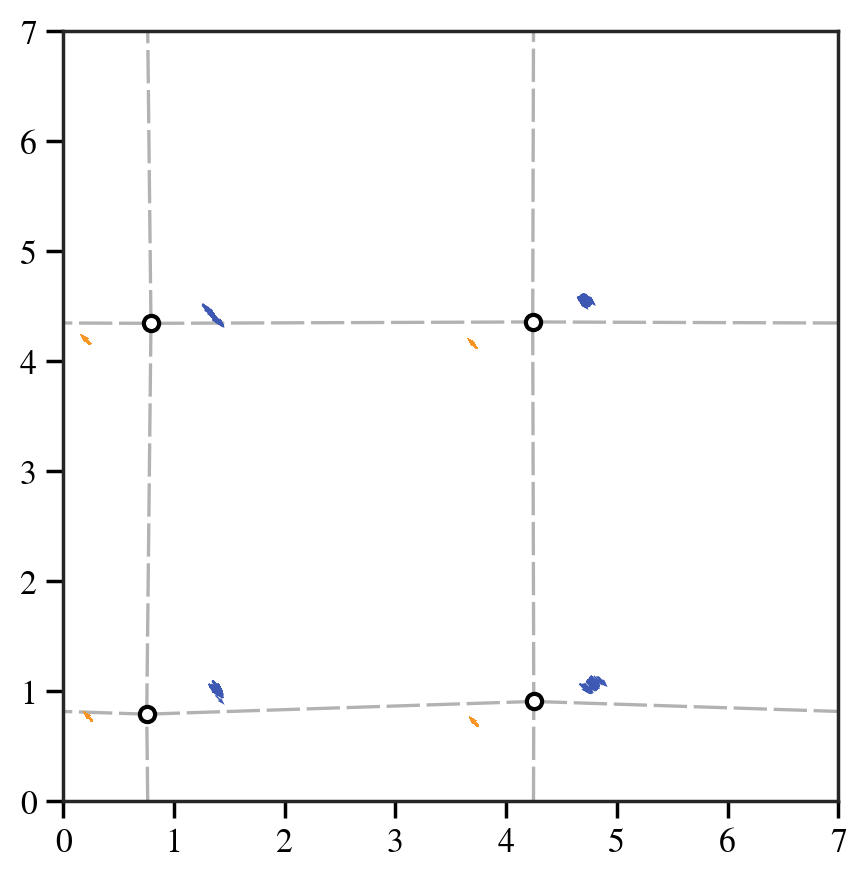

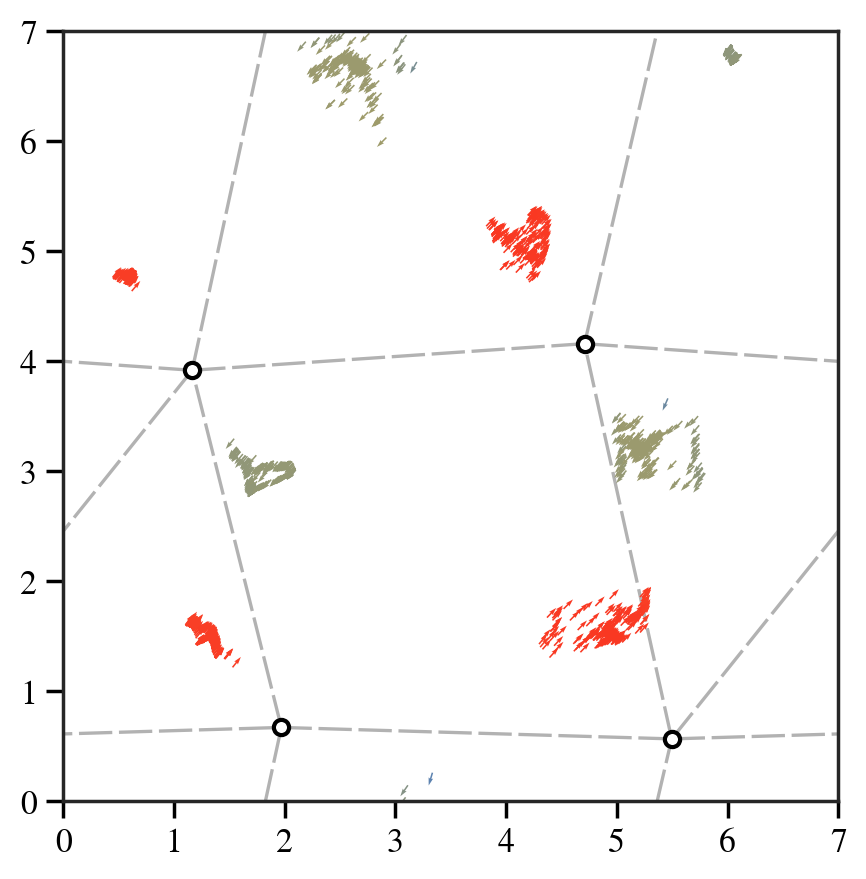

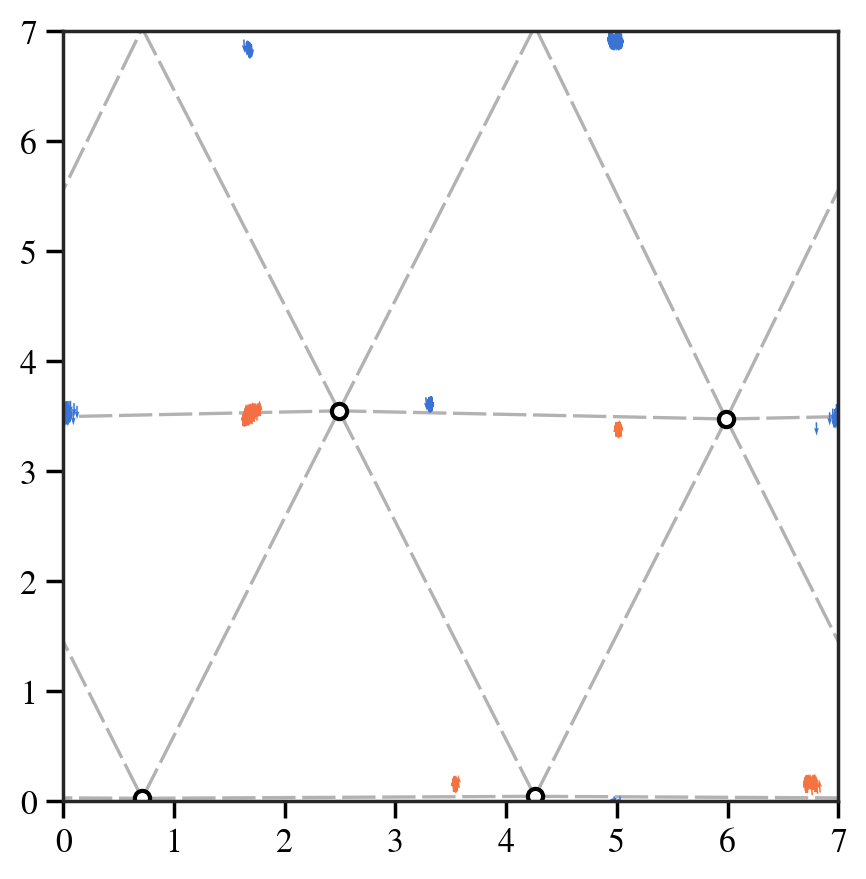

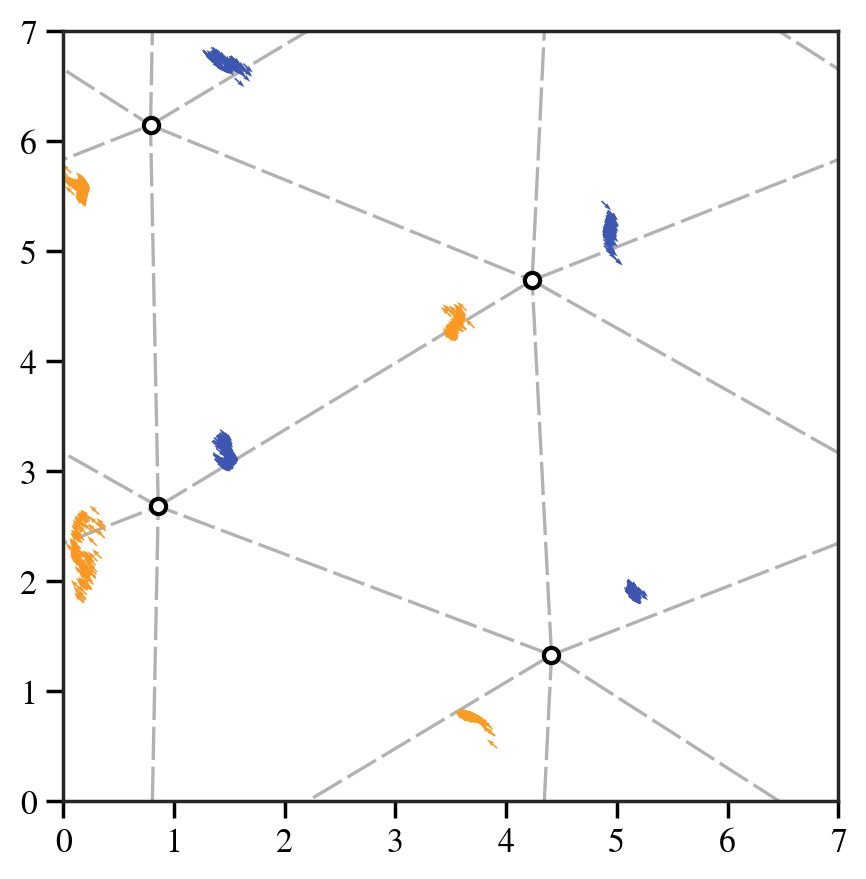

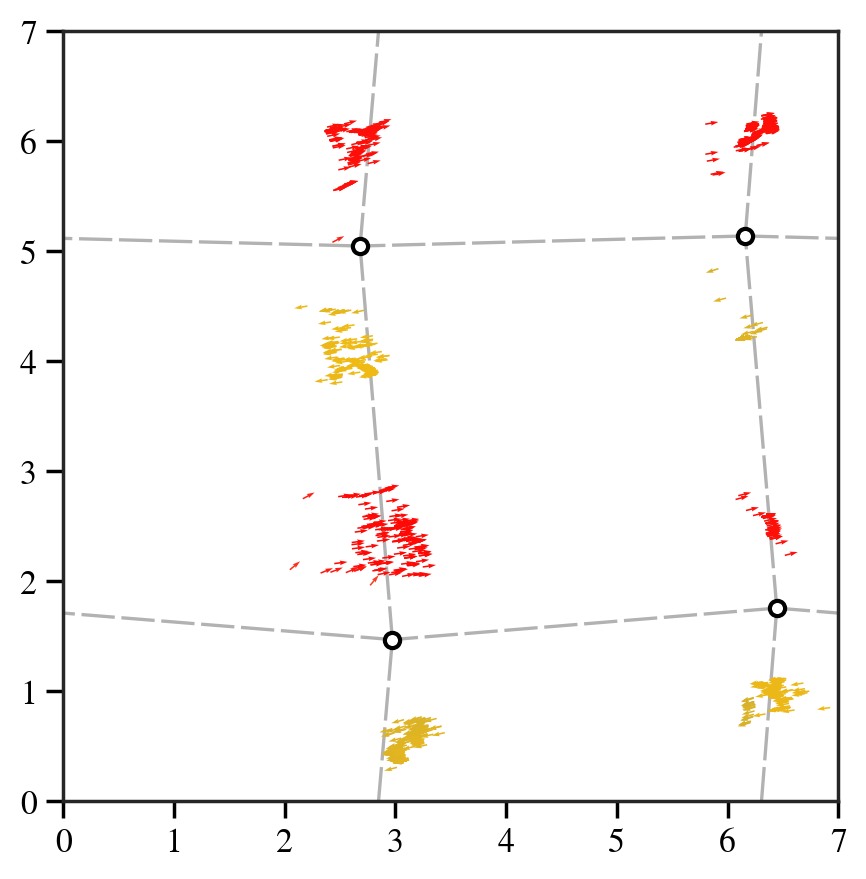

...

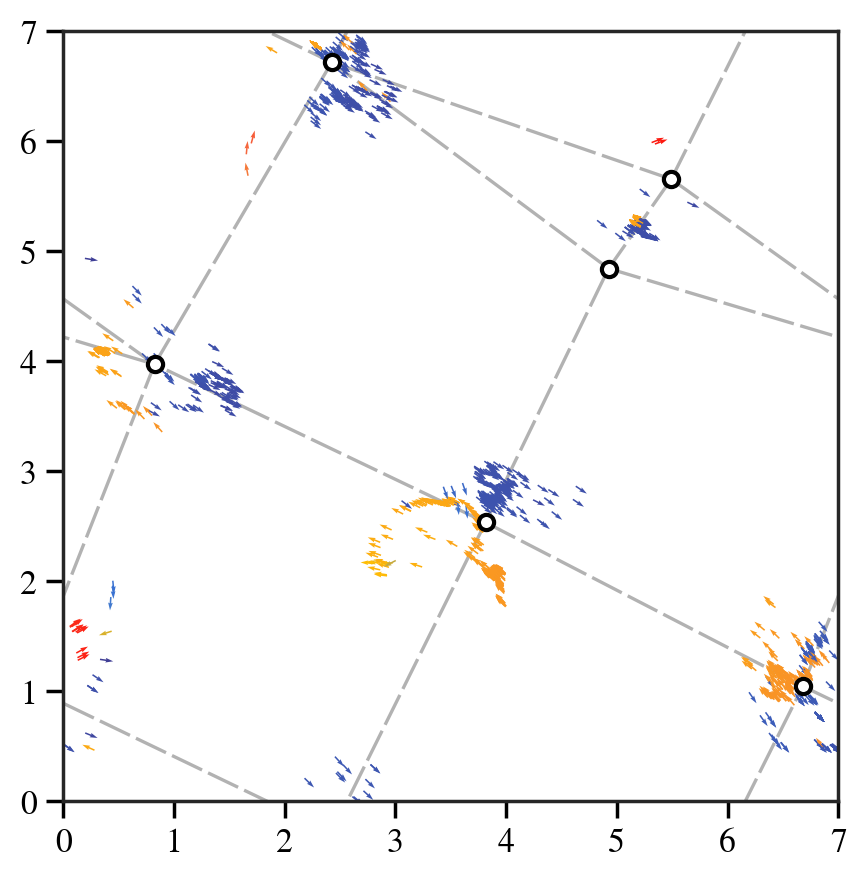

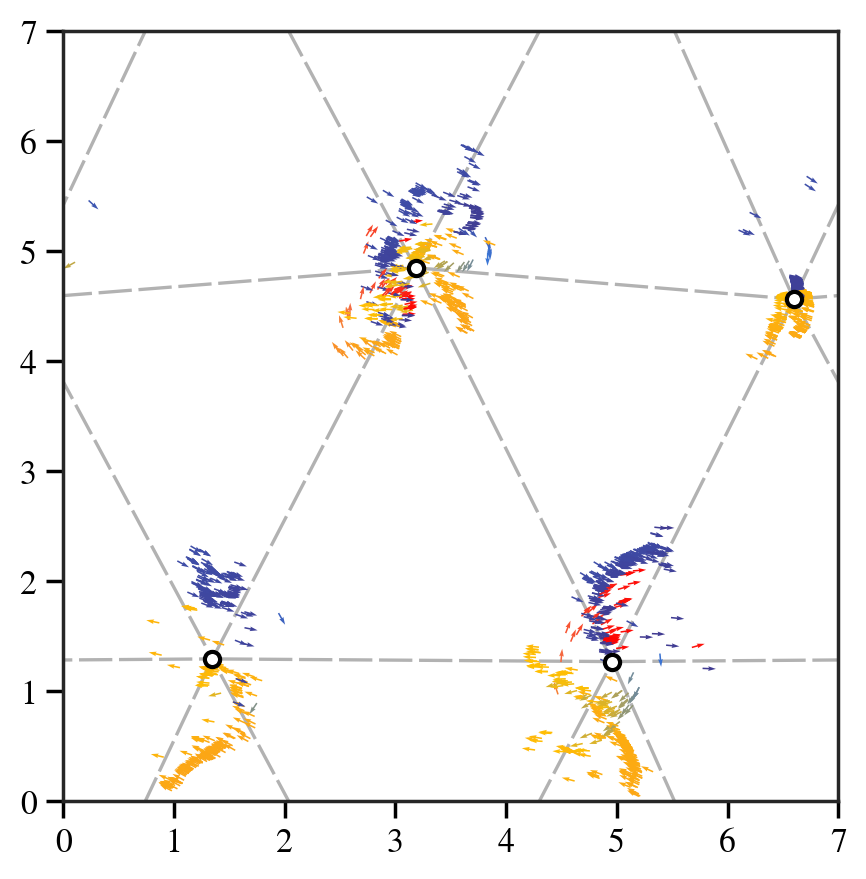

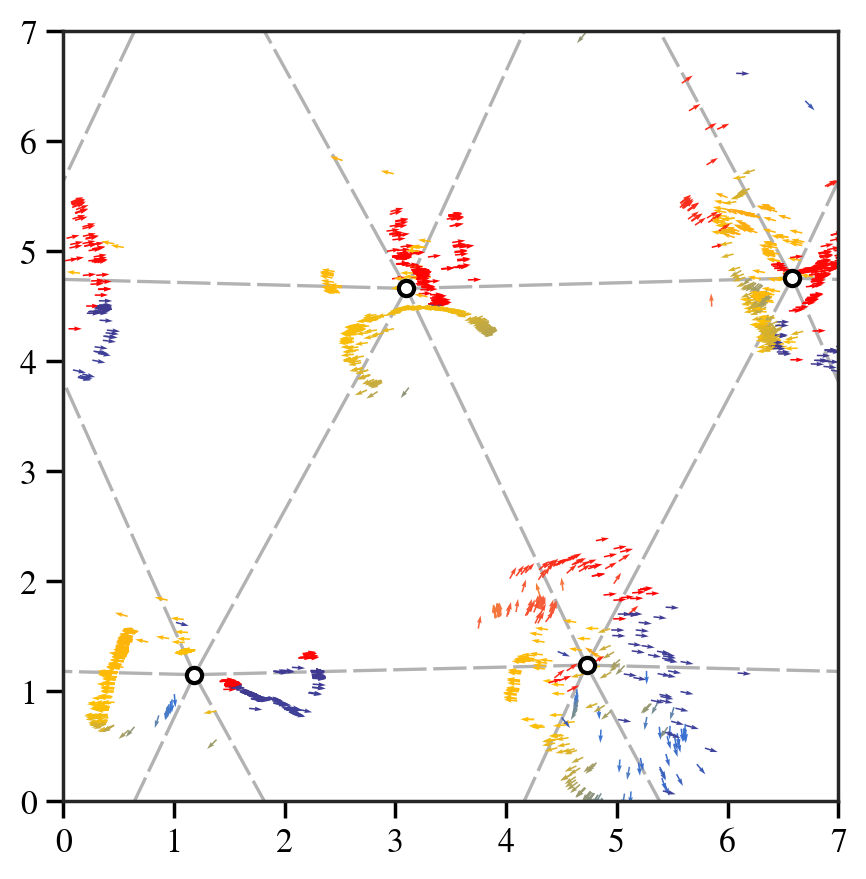

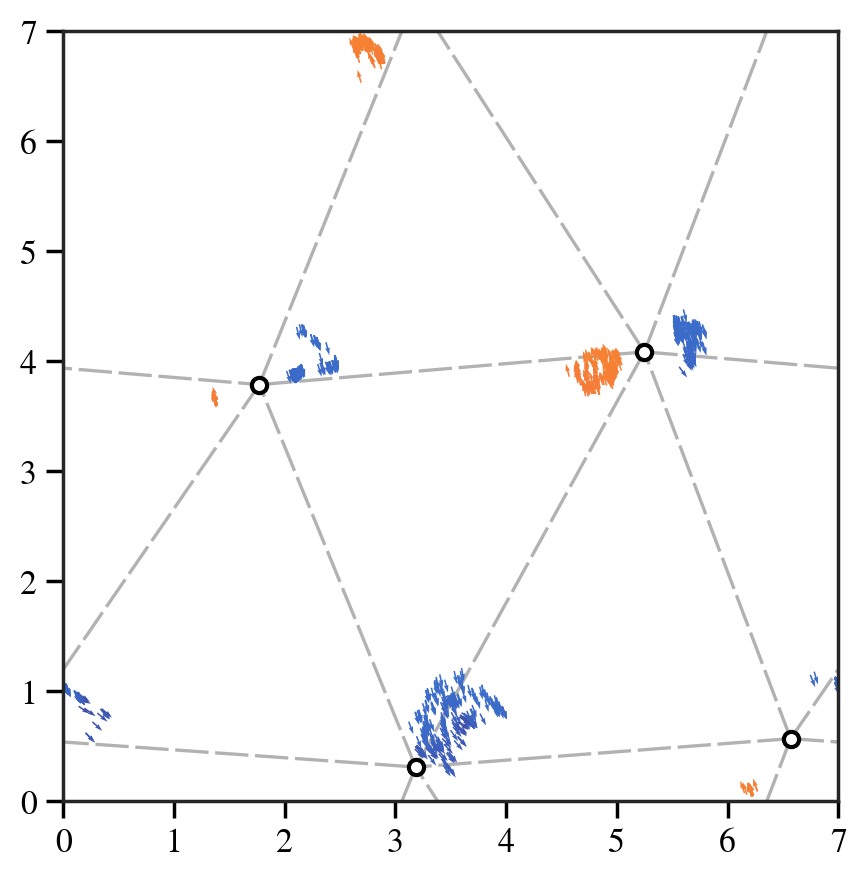

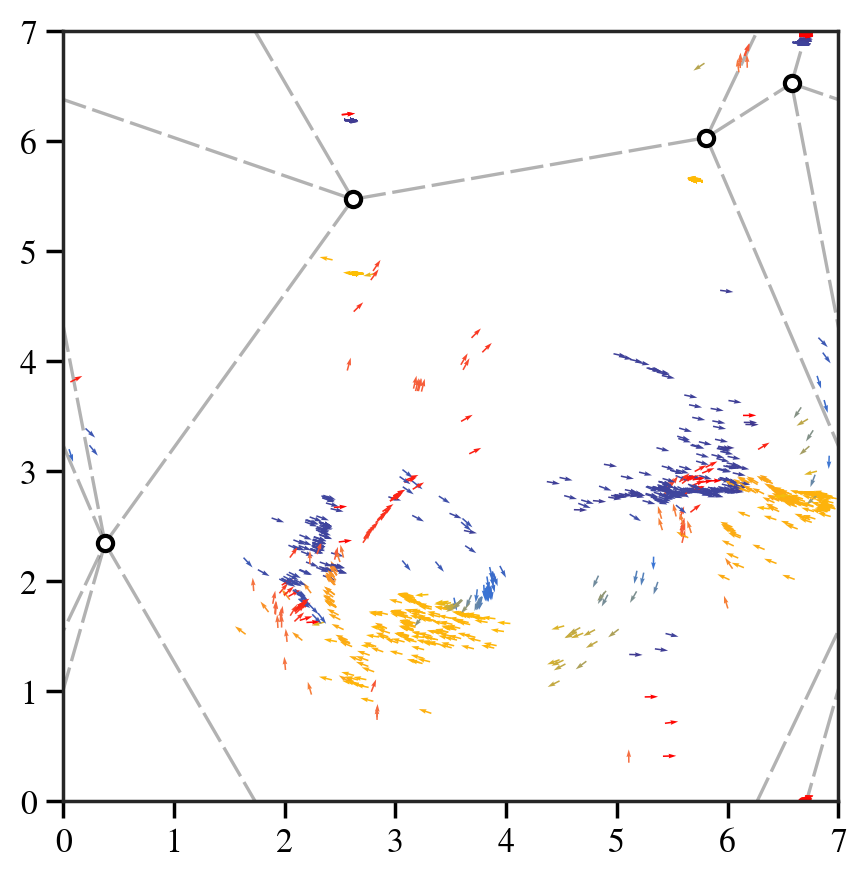

In [10]:
# selectedSas = sas
selectD0s = distanceD0s[:]#[(1 < distanceD0s) & (distanceD0s < 1.05)]
selectKs = strengthKs[:]#[strengthKs > 12]
selectedSas = [
    sa for sa in sas 
    if (sa is not None) and 
    (sa.model.distanceD0 in selectD0s) and 
    (sa.model.strengthK in selectKs)
]

classAnalRadius = dict()
edgeDistances = dict()

for sa in tqdm(selectedSas, total=len(selectedSas)):
    key = (sa.model.strengthK, sa.model.distanceD0)
    classAnalRadius[key] = []
    edgeDistances[key] = []
    for lookIdx in [-1]:
        analRadius, edgeDistance = calc_lattice_constants(sa, plot=True, lookIdx=lookIdx)
        classAnalRadius[key].append(analRadius)
        edgeDistances[key].append(edgeDistance)
    # print(rf"$K={sa.model.strengthK:.2f},d_0={sa.model.distanceD0:.2f}$")

d:\Programs\anaconda3\envs\p312\Lib\site-packages\numpy\_core\fromnumeric.py:3860: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
d:\Programs\anaconda3\envs\p312\Lib\site-packages\numpy\_core\_methods.py:145: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
d:\Programs\anaconda3\envs\p312\Lib\site-packages\numpy\_core\_methods.py:223: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
d:\Programs\anaconda3\envs\p312\Lib\site-packages\numpy\_core\_methods.py:181: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
d:\Programs\anaconda3\envs\p312\Lib\site-packages\numpy\_core\_methods.py:215: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


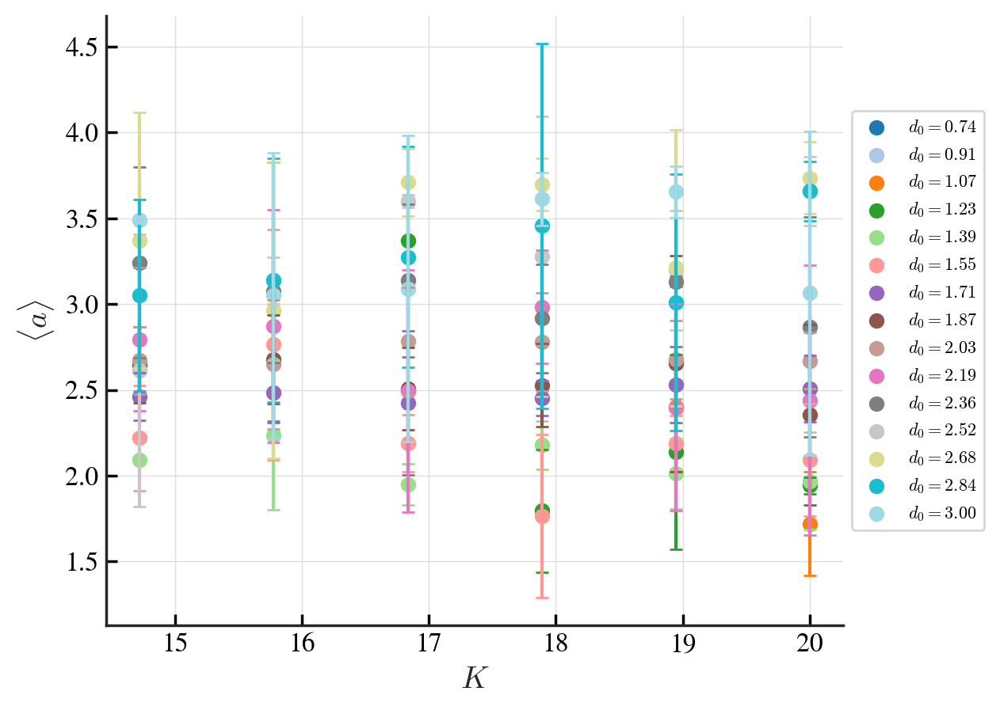

In [11]:
selectD0s = distanceD0s[:][(0.6 < distanceD0s)]
selectKs = strengthKs[:][strengthKs > 14]

fig, ax = plt.subplots(figsize=(6, 5))
colors = plt.cm.tab20(np.linspace(0, 1, len(selectD0s)))

for i, selectD0 in enumerate(selectD0s[:]):
    meanEdgeDistances = np.array([np.mean(edgeDistances[(strengthK, selectD0)]) for strengthK in selectKs])
        
    stdEdgeDistances = np.array([np.std(edgeDistances[(strengthK, selectD0)]) for strengthK in selectKs])
    linspaceKs = np.linspace(selectKs[0], selectKs[-1], 100)
    analysisDis = selectD0 + 2 * model.speedV / np.abs(linspaceKs * np.sin(model.phaseLagA0))

    color = colors[i]
    # plt.plot(linspaceKs, analysisDis, ls="--", color=color)
    ax.errorbar(selectKs, meanEdgeDistances, yerr=stdEdgeDistances,
                color="none", ecolor=color, capsize=3, ms=4)
    ax.scatter(selectKs, meanEdgeDistances, color=color, label=f"$d_0={selectD0:.2f}$")

# plt.ylim(0.5, 2)
plt.tick_params(length=5, direction="in")
plt.gca().spines["top"].set_visible(False)
plt.gca().spines["right"].set_visible(False)
plt.grid()
plt.xlabel(r"$K$", fontsize=14)
plt.ylabel(r"$\langle a \rangle$", fontsize=14)
plt.legend(fontsize=8, loc='center left', bbox_to_anchor=(1, 0.5))
# plt.savefig("figs/lattice_constant.pdf", bbox_inches="tight")

In [12]:
from scipy.linalg import eig
from scipy.special import j1
from matplotlib.collections import LineCollection

def theta_k(k, d0):
    if isinstance(k, (list, np.ndarray)):
        k_norm = np.linalg.norm(k)
    else:
        k_norm = k
        
    if k_norm == 0:
        return np.pi * d0**2
    else:
        return (2 * np.pi * d0 / k_norm) * j1(k_norm * d0)

def lambda_m(k: float | List | np.ndarray, d0: float, K: float, alpha: float):
    theta0 = theta_k(0, d0)
    thetaK = theta_k(k, d0)
    return K * thetaK / (theta0 * 2) * np.cos(alpha)

def get_zero_points_diff(K: float, d0: float):
    kNorms = np.linspace(0., 100, 10000)
    lambda_ms = np.array([
        lambda_m(kNorm, d0=d0, K=K, alpha=0.6 * np.pi) 
        for kNorm in kNorms
    ])
    alphaBase = 0.2
    alpha = alphaBase + (d0 / distanceD0s[-1]) * (1 - alphaBase)
    # plt.plot(kNorms, lambda_ms, label=f"$d_0={d0:.2f}$", color="C2", alpha=alpha)
    zeroPoint = kNorms[(np.roll(lambda_ms, 1) * lambda_ms < 0) & (kNorms > 0)]
    return np.mean(np.diff(zeroPoint))
    # return zeroPoint[0]
    
    # kNorm = kNorms[np.argmax(lambda_ms)]
    # return kNorm

def get_first_peak(K: float, d0: float):
    kNorms = np.linspace(0., 100, 10000)
    lambda_ms = np.array([
        lambda_m(kNorm, d0=d0, K=K, alpha=0.6 * np.pi) 
        for kNorm in kNorms
    ])    
    kNorm = kNorms[np.argmax(lambda_ms)]
    # plt.plot(kNorms, lambda_ms, label=f"$d_0={d0:.2f}$", color="C2", alpha=alpha)
    # plt.scatter(kNorm, lambda_ms[np.argmax(lambda_ms)], color="C3")
    return kNorm

def compute_eigenvalues_for_k(k: float, params: dict, M: int = 10):
    """
    params: dict:
        - v: speedV
        - K: coupling strength
        - d0: coupling radius
        - alpha: phase frustration
    M: truncated basis size (m from -M to M)
    """
    v = params['v']
    K = params['K']
    d0 = params['d0']
    alpha = params['alpha']
    
    m_values = np.arange(-M, M+1)
    dim = len(m_values)
    
    L0 = np.zeros((dim, dim), dtype=complex)
    besselTerm = K * j1(k*d0) / (k*d0)
    for i, m in enumerate(m_values):
        if m == 1 or m == -1:
            L0[i,i] = besselTerm * np.exp(-m * alpha * 1j)
    
    L1 = np.zeros((dim, dim), dtype=complex)
    for i in range(1, dim):
        L1[i-1, i] = 0.5  # upper line
        L1[i, i-1] = 0.5  # lower line
    
    H = L0 - 1j * v * k * L1
    eigenvalues = eig(H)[0]
    
    # sort with Real part
    return eigenvalues[np.argsort(eigenvalues.real)].round(3)

def calc_break_K(kValues: np.ndarray, params: dict, M: int = 10):
    allEvals = []
    for k in kValues:
        evals = compute_eigenvalues_for_k(k, params, M)
        allEvals.append(evals)
    
    allEvals = np.array(allEvals)  # allEvals.shape == (len(kValues), 2M+1)
    
    # create segments set for eval curves
    segments = []
    for i in range(allEvals.shape[1]):
        points = np.array([kValues, allEvals[:,i].real]).T.reshape(-1,1,2)
        # points.shape == (len(kValues), 1, 2), (1, 2) ~  a point in k-eval Fig
        segments.append(np.concatenate([points[:-1], points[1:]], axis=1))
        # segments.shape == (len(kValues), 2, 2)
        # (2, 2) ~ 2 adjacent points in k-eval Fig
    
    segments = np.concatenate(segments, axis=0)
    
    posK = []

    # mark the positive evals
    for i in range(allEvals.shape[1]):
        realEvals = allEvals[:,i].real
        positiveIdx = np.where(realEvals > 0)[0]
        if len(positiveIdx) > 0:
            posK.append(kValues[positiveIdx[0]])

    return np.unique(posK)

def get_first_break_k(params):
    alphaPluss = np.arange(0, 0.01, 0.0001)
    for alphaPlus in alphaPluss:
        params["alpha"] = 0.5 * np.pi + alphaPlus

        boundaryLength = 7
        kValues = np.arange(1, 100) * 2 * np.pi / boundaryLength

        posK = calc_break_K(kValues, params, M=10)
        if len(posK) == 1:
            firstBreakK = posK[0]
            break
        if len(posK) > 1:
            assert False, "More than one positive k* found"

    return firstBreakK

In [14]:
strengthKs = np.linspace(1, 20, 19)
distanceD0s = np.linspace(0.1, 3, 19)  
selectD0s = distanceD0s[:][(0.6 < distanceD0s)]
selectKs = strengthKs[:][14 < strengthKs]
firstBreakKs = dict()
for K, d0 in tqdm(product(selectKs, selectD0s), total=len(selectKs) * len(selectD0s)):
    params = {
        'v': 3,
        'K': K,
        'd0': d0,
    }
    firstBreakK = get_first_break_k(params)
    firstBreakKs[(K, d0)] = firstBreakK

  0%|          | 0/90 [00:00<?, ?it/s]

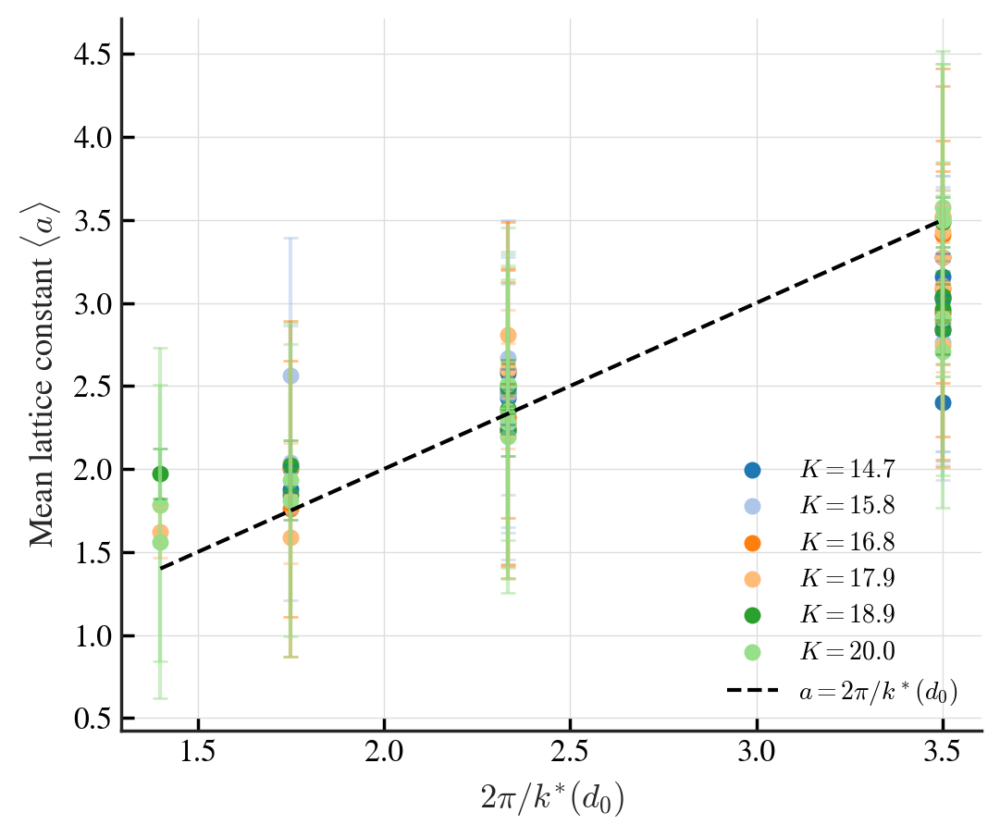

In [15]:
colors = plt.cm.tab20(np.linspace(0, 1, len(strengthKs)))

selectD0s = distanceD0s[:][(0.6 < distanceD0s)]
selectKs = strengthKs[:][14 < strengthKs]
# kValues = np.linspace(0.0001, 10, 500)
boundaryLength = 7
kValues = np.arange(1, 10) * 2 * np.pi / boundaryLength
phaseLagA0 = 0.6 * np.pi
speedV = 3
totalKStars = list()
totalMeanEdgeDistances = list()

for i, K in enumerate(selectKs):
    kStars = list()
    meanEdgeDistances = list()
    
    for d0 in selectD0s:
        # zeroPointsDiff = get_first_peak(K, d0)
        # zeroPointsDiff = get_zero_points_diff(K, d0)
        params = {
            'v': speedV,         # speed
            'K': K,              # coupling strength
            'd0': d0,            # coupling radius
            'alpha': phaseLagA0  # phase frustration
        }
        firstPosK = firstBreakKs[(K, d0)]
        edgeDistance = edgeDistances[(K, d0)][0]
        if len(edgeDistance) < 20:
            continue
        meanEdgeDistance = np.mean(edgeDistance) - speedV / np.abs(K * np.sin(phaseLagA0))
        stdEdgeDistance = np.std(edgeDistance)
        kStars.append(2 * np.pi / firstPosK)
        meanEdgeDistances.append(meanEdgeDistance)
    
    color=colors[i]
    plt.scatter(
        kStars, meanEdgeDistances, 
        s=30, alpha=1, label=f"$K={K:.1f}$", color=color
    )
    plt.errorbar(kStars, meanEdgeDistances, yerr=stdEdgeDistance,
                 color="none", ecolor=color, capsize=3, alpha=0.5)
    totalKStars += kStars
    totalMeanEdgeDistances += meanEdgeDistances

# 拟合
argsort = np.argsort(totalKStars)
totalKStars = np.array(totalKStars)[argsort]
totalMeanEdgeDistances = np.array(totalMeanEdgeDistances)[argsort]
# slope, intercept, r_value, p_value, std_err = stats.linregress(
#     totalKStars, totalMeanEdgeDistances
# )
slope, intercept = 1, 0
plt.plot(totalKStars, 
         slope * totalKStars + intercept,
         color="black", linestyle="--", linewidth=1.5, label=rf"$a=2\pi/k^*(d_0)$")

plt.tick_params(length=5, direction="in")
plt.gca().spines["top"].set_visible(False)
plt.gca().spines["right"].set_visible(False)
plt.grid()
plt.xlabel(r"$2\pi / k^{*}(d_0)$")
plt.ylabel(r"Mean lattice constant $\langle a\rangle$")
plt.legend(frameon=False, loc="lower right", fontsize=10)
# plt.savefig("figs/lattice_constant_vs_kstar.pdf", bbox_inches="tight")

In [ ]:
speedV / np.abs(K * np.sin(phaseLagA0))

In [9]:
analRadius

array([0.15771933, 0.15771933, 0.15771933, 0.15771933, 0.15771933,
       0.15771933, 0.15771933, 0.15771933, 0.15771933, 0.15771933,
       0.15771933, 0.15771933, 0.15771933, 0.15771933, 0.15771933,
       0.15771933, 0.15771933, 0.15771933, 0.15771933, 0.15771933,
       0.15771933, 0.15771933, 0.15771933, 0.15771933, 0.15771933])

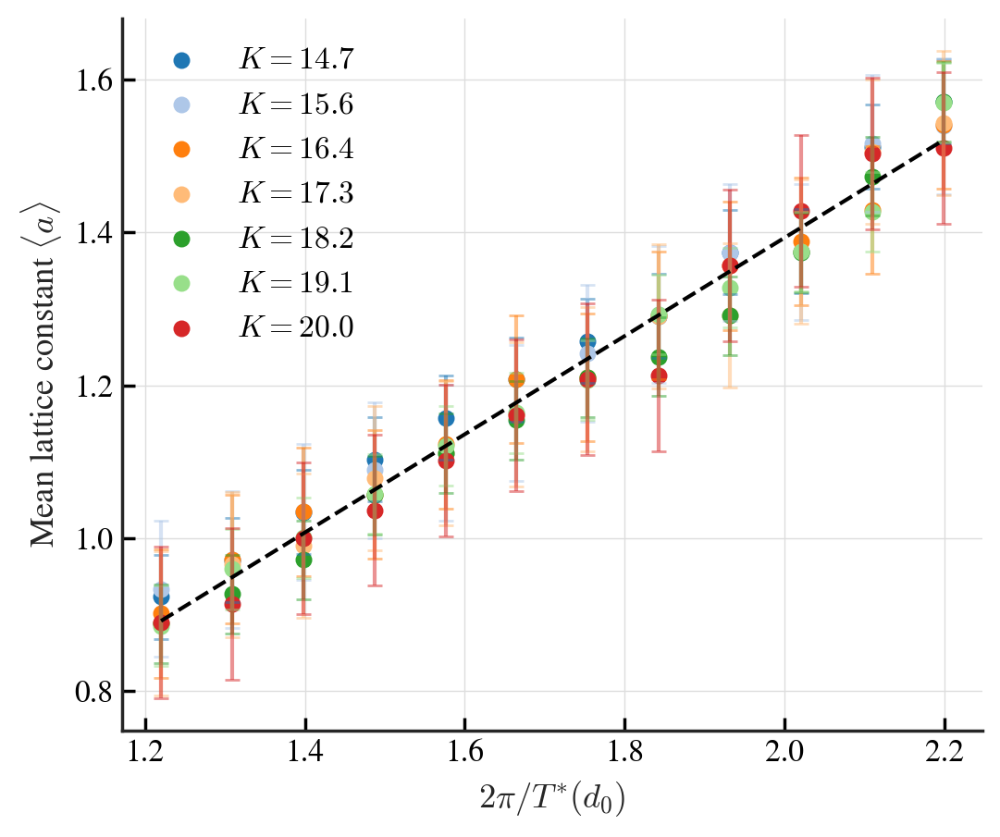

In [ ]:
from scipy import stats

colors = plt.cm.tab20(np.linspace(0, 1, len(strengthKs)))

selectD0s = distanceD0s[:][(0.6 < distanceD0s)]
selectKs = strengthKs[:][14 < strengthKs]
totalKStars = list()
totalMeanEdgeDistances = list()

for i, K in enumerate(selectKs):
    kStars = list()
    meanEdgeDistances = list()
    
    for d0 in selectD0s:
        # zeroPointsDiff = get_first_peak(K, d0)
        zeroPointsDiff = get_zero_points_diff(K, d0)
        edgeDistance = edgeDistances[(K, d0)][0]
        if len(edgeDistance) < 20:
            continue
        meanEdgeDistance = np.mean(edgeDistance)
        stdEdgeDistance = np.std(edgeDistance)
        kStars.append(2 * np.pi / zeroPointsDiff)
        meanEdgeDistances.append(meanEdgeDistance)
    
    color=colors[i]
    plt.scatter(
        kStars, meanEdgeDistances, 
        s=30, alpha=1, label=f"$K={K:.1f}$", color=color
    )
    plt.errorbar(kStars, meanEdgeDistances, yerr=stdEdgeDistance,
                 color="none", ecolor=color, capsize=3, alpha=0.5)
    totalKStars += kStars
    totalMeanEdgeDistances += meanEdgeDistances

# 拟合
argsort = np.argsort(totalKStars)
totalKStars = np.array(totalKStars)[argsort]
totalMeanEdgeDistances = np.array(totalMeanEdgeDistances)[argsort]
slope, intercept, r_value, p_value, std_err = stats.linregress(
    totalKStars, totalMeanEdgeDistances
)
plt.plot(totalKStars, 
         slope * totalKStars + intercept,
         color="black", linestyle="--", linewidth=1.5)

plt.tick_params(length=5, direction="in")
plt.gca().spines["top"].set_visible(False)
plt.gca().spines["right"].set_visible(False)
plt.grid()
plt.xlabel(r"$2\pi / T^{*}(d_0)$")
plt.ylabel(r"Mean lattice constant $\langle a\rangle$")
plt.legend(frameon=False)
plt.savefig("figs/lattice_constant_vs_kdiff.pdf", bbox_inches="tight")

In [ ]:
# selectD0s = distanceD0s[1:]  # 3000 uniform
# selectKsDict = {
#     selectD0s[0]: strengthKs[-2:],
#     selectD0s[1]: strengthKs[2:],
#     selectD0s[2]: strengthKs[2:],
#     selectD0s[3]: strengthKs[1:],
#     selectD0s[4]: strengthKs[1:],
#     selectD0s[5]: strengthKs[1:],
# }
selectD0s = distanceD0s[2:]  # 2000 cauchy
selectKsDict = {
    selectD0s[0]: strengthKs[-3:],
    selectD0s[1]: strengthKs[3:],
    selectD0s[2]: strengthKs[3:],
    selectD0s[3]: strengthKs[3:],
    selectD0s[4]: strengthKs[2:]
}

fig, ax = plt.subplots(figsize=(6, 5))

for i, selectD0 in enumerate(selectD0s):
    meanEdgeDistances = [edgeDistances[(strengthK, selectD0)].mean() for strengthK in selectKsDict[selectD0]]
    stdEdgeDistances = [edgeDistances[(strengthK, selectD0)].std() for strengthK in selectKsDict[selectD0]]
    # analysisDis = [
    #     selectD0 + 2 * model.speedV / np.abs(strengthK * np.sin(model.phaseLagA0))
    #     for strengthK in selectKsDict[selectD0]
    # ]
    linspaceKs = np.linspace(
        selectKsDict[selectD0][0], selectKsDict[selectD0][-1], 100
    )
    analysisDis = selectD0 + 2 * model.speedV / np.abs(linspaceKs * np.sin(model.phaseLagA0))

    plt.plot(linspaceKs, analysisDis, ls="--")
    # ax.errorbar(selectKsDict[selectD0], meanEdgeDistances, yerr=stdEdgeDistances,
    #             color="none", ecolor=f"C{i}", capsize=3, ms=4)
    ax.scatter(selectKsDict[selectD0], meanEdgeDistances, color=f"C{i}", label=f"$d_0={selectD0:.2f}$")

plt.legend(fontsize=8)
# plt.ylim(0, 1.5)

In [ ]:
model.distanceD0 + 2 * model.speedV / np.abs(model.strengthK * np.sin(model.phaseLagA0))

In [ ]:
plt.plot([i.mean() for i in edgeDistances.values()])
plt.axhline(y=model.distanceD0 + 2 * model.speedV / np.abs(model.strengthK * np.sin(model.phaseLagA0)),
            color="black", ls="--", lw=1.5, label="Theoretical distance")

In [ ]:
# model = [model for model in models 
#       if (model.distanceD0 == distanceD0s[2]) and 
#       (model.strengthK == strengthKs[-1])][0]
# sa = StateAnalysis(model)

sa: StateAnalysis = [sa for sa in sas
      if (sa.model.distanceD0 == distanceD0s[2]) and
      (sa.model.strengthK == strengthKs[-1])][0]
model = sa.model

shift = np.array([0., 0.])
analysisRadius = model.speedV / np.abs(model.strengthK * np.sin(model.phaseLagA0))

classes, centers = sa.calc_classes_and_centers(classDistance=analysisRadius, lookIdx=-1)
if len(classes) > model.agentsNum * 0.2:
    print(f"Too many classes: {len(classes)} > {model.agentsNum * 0.2}, skipping.")
    # return [], [], []
numInClasses = np.array([len(c) for c in classes])
# zScoreNum = stats.zscore(numInClasses)
# classes = [classes[c] for c in range(len(classes)) 
#            if (zScoreNum[c] > -0.4) and (numInClasses[c] > 10)]
numThres = np.median(numInClasses[numInClasses > 10]) * 0.
classes = [classes[c] for c in range(len(classes))
            if (numInClasses[c] > max(numThres, 10))]
centers = np.mod(centers + shift, model.boundaryLength)
if len(classes) <= 1:
    print("Not enough classes, skipping.")
    # return [], [], []

classCenters: List[np.ndarray] = []
for c in classes:
    singleClassCenters = centers[c]

    maxDeltaX = np.abs(singleClassCenters[:, 0] - singleClassCenters[:, 0, np.newaxis]).max()
    subXShift = model.halfBoundaryLength if maxDeltaX > model.halfBoundaryLength else 0
    maxDeltaY = np.abs(singleClassCenters[:, 1] - singleClassCenters[:, 1, np.newaxis]).max()
    subYShift = model.halfBoundaryLength if maxDeltaY > model.halfBoundaryLength else 0

    singleClassCenters = np.mod(singleClassCenters - np.array([subXShift, subYShift]), model.boundaryLength)
    classCenter = np.mod(singleClassCenters.mean(axis=0) + np.array([subXShift, subYShift]), model.boundaryLength)
    classCenters.append(classCenter)
classCenters: np.ndarray = np.array(classCenters)

len(classes)

In [ ]:
sa.plot_spatial(colorsBy="phase", index=-1, shift=shift)
plt.scatter(
    classCenters[:, 0], classCenters[:, 1],
    facecolor="white", s=30, edgecolor="black", lw=1.5
)

In [ ]:
from scipy import stats

shift = np.array([0., 0.])
analysisRadius = model.speedV / np.abs(model.strengthK * np.sin(model.phaseLagA0))

classes, centers = sa.calc_classes_and_centers(classDistance=analysisRadius, lookIdx=-1)
if len(classes) > model.agentsNum * 0.2:
    print(f"Too many classes: {len(classes)} > {model.agentsNum * 0.2}, skipping.")
    # return [], []
numInClasses = np.array([len(c) for c in classes])
# zScoreNum = stats.zscore(numInClasses)
# classes = [classes[c] for c in range(len(classes)) 
#            if (zScoreNum[c] > -0.4) and (numInClasses[c] > 10)]
numThres = np.median(numInClasses[numInClasses > 10]) * 0.
classes = [classes[c] for c in range(len(classes))
            if (numInClasses[c] > max(numThres, 10))]
centers = np.mod(centers + shift, model.boundaryLength)
if len(classes) <= 1:
    print("Not enough classes, skipping.")
    # return [], [], []

classCenters: List[np.ndarray] = []
for c in classes:
    singleClassCenters = centers[c]

    maxDeltaX = np.abs(singleClassCenters[:, 0] - singleClassCenters[:, 0, np.newaxis]).max()
    subXShift = model.halfBoundaryLength if maxDeltaX > model.halfBoundaryLength else 0
    maxDeltaY = np.abs(singleClassCenters[:, 1] - singleClassCenters[:, 1, np.newaxis]).max()
    subYShift = model.halfBoundaryLength if maxDeltaY > model.halfBoundaryLength else 0

    singleClassCenters = np.mod(singleClassCenters - np.array([subXShift, subYShift]), model.boundaryLength)
    classCenter = np.mod(singleClassCenters.mean(axis=0) + np.array([subXShift, subYShift]), model.boundaryLength)
    classCenters.append(classCenter)
classCenters: np.ndarray = np.array(classCenters)

edges, ajdClassCenters = sa.calc_nearby_edges(
    classCenters=classCenters, 
    stdMulti=0.3,
    relativeDistance=False
)

In [ ]:
fig, ax = plt.subplots(figsize=(5, 5))

plt.scatter(
    classCenters[:, 0], classCenters[:, 1],
    facecolor="white", s=30, edgecolor="black", lw=1.5
)

for edge in edges[:]:
    plt.plot(ajdClassCenters[edge, 0], ajdClassCenters[edge, 1],
             color="black", lw=1.2, alpha=0.3, zorder=0
            #  linestyle=(0, (10, 2))
             )
    # edgeCenter = (ajdClassCenters[edge[0]] + ajdClassCenters[edge[1]]) / 2
    # edgeNodesDelta = ajdClassCenters[edge[0]] - ajdClassCenters[edge[1]]
    # edgeAngle = np.arctan2(edgeNodesDelta[1], edgeNodesDelta[0])
    # edgeShift = np.array([np.cos(edgeAngle), np.sin(edgeAngle)]) * 0.5 * model.distanceD0

    # plt.plot([edgeCenter[0] - edgeShift[0], edgeCenter[0] + edgeShift[0]], 
    #          [edgeCenter[1] - edgeShift[1], edgeCenter[1] + edgeShift[1]],
    #          lw=2, alpha=1, color="gray", ls="-")

analRadius = model.speedV / np.abs(model.strengthK * np.sin(model.phaseLagA0))

for classCenter in classCenters:
    circle = plt.Circle(
        classCenter, analRadius * 1, color="black", fill=False, lw=1, alpha=1, ls="-"
    )
    ax.add_artist(circle)

sa.plot_spatial(ax=ax, colorsBy="phase", index=-1, shift=shift)

# for i, classCenter in enumerate(classCenters):
#     plt.text(
#         classCenter[0] + 0.01, classCenter[1] + 0.1, 
#         f"{i}", ha="left", va="bottom", fontsize=12, color="black"
#     )

plt.tick_params(length=3, direction="in")


In [ ]:
model.distanceD0 + analRadius * 2

In [ ]:
relativeEdges = np.unique(np.mod(edges, len(classes)), axis=0)
np.mean([
    sa.calc_replative_distance(classCenters[edge[0]], classCenters[edge[1]])
    # np.linalg.norm(classCenters[edge[0]] - classCenters[edge[1]])
    for edge in relativeEdges
])

In [ ]:
np.mean([
    np.linalg.norm(ajdClassCenters[edge[0]] - ajdClassCenters[edge[1]])
    for edge in edges
])